In [1]:
import os
import sys
root_folder = os.path.dirname(os.getcwd())
sys.path.append(root_folder)
from ResoFit._pulse_shape import NeutronPulse
from ResoFit._pulse_shape import ProtonPulse
from ResoFit.experiment import Experiment
import numpy as np
from ResoFit.simulation import Simulation
overwrite_csv = False
import scipy.signal as ss
import matplotlib.pyplot as plt
import plotly
plotly.offline.init_notebook_mode()
import plotly.graph_objs as go

'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/Neutron_fitted_params_1eV_500eV_ikeda_carpenter.csv' exists...
Fitted parameters file loaded.
'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/Loglog_linear_within_1eV_500eV_ikeda_carpenter.csv' exists...
Parameters linear fitted file loaded.
'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/TOF_shape_eV_7.0_150.0_0.1_us_0.05_5500000.0_30054.6445355_for_sum_proton_ikeda_carpenter.csv' exists...
TOF neutron beam shape file loaded.
                     7.0           7.1           7.2           7.3  \
tof_us                                                               
97.230491   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.239301   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.248701   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.258711   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   

'Time (us)' was obtained with the following:
source_to_detector_m=16.45
offset_us=2.67


Text(0.5,1,'Proton convolved')

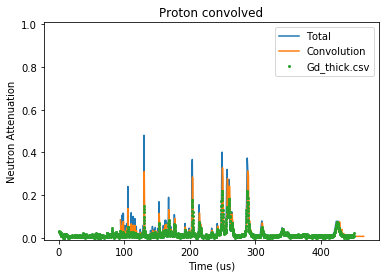

In [2]:
convolve_proton = True
if convolve_proton:
    title = 'Proton convolved'
else:
    title = 'No proton convolved'

simulation = Simulation(energy_min=7, energy_max=150, energy_step=0.1, database='ENDF_VII')
simulation.add_layer(layer='Gd', layer_thickness_mm=0.15)
simulation._convolve_beam_shape(convolve_proton=convolve_proton, sigma=200)

folder = 'data/IPTS_19558/reso_data_19558'
data_file1 = 'Gd_thick.csv'
spectra_file = 'Image002_Spectra.txt'
experiment1 = Experiment(data_file=data_file1,
                         spectra_file=spectra_file,
                         folder=folder,
                         baseline=True)
# experiment1.slice(slice_start=300, reset_index=False)
# peak_df = experiment1.find_peak()
simulation.plot_simu(x_type='time', source_to_detector_m=16.45, offset_us=2.67)
plt.plot(simulation.x_tof_us-2.9, simulation.y_att, label='Convolution')
experiment1.plot_raw(x_type='time', time_unit='us')
plt.title(title)

'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/Neutron_fitted_params_1eV_500eV_ikeda_carpenter.csv' exists...
Fitted parameters file loaded.
'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/Loglog_linear_within_1eV_500eV_ikeda_carpenter.csv' exists...
Parameters linear fitted file loaded.
'/Users/y9z/Documents/GitHub/ResoFit/ResoFit/result/neutron_pulse/ikeda_carpenter/TOF_shape_eV_7.0_150.0_0.1_us_0.05_5500000.0_30054.6445355_for_sum_proton_ikeda_carpenter.csv' exists...
TOF neutron beam shape file loaded.
                     7.0           7.1           7.2           7.3  \
tof_us                                                               
97.230491   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.239301   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.248701   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
97.258711   0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   

'Time (us)' was obtained with the following:
source_to_detector_m=16.45
offset_us=2.67


Text(0.5,1,'Proton convolved')

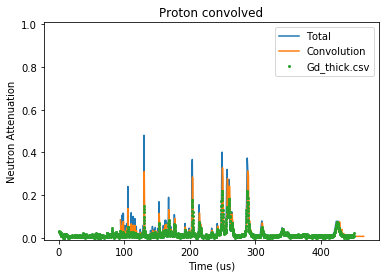

In [12]:
convolve_proton = True
if convolve_proton:
    title = 'Proton convolved'
else:
    title = 'No proton convolved'

simulation = Simulation(energy_min=7, energy_max=150, energy_step=0.1, database='ENDF_VII')
simulation.add_layer(layer='Gd', layer_thickness_mm=0.15)
simulation._convolve_beam_shape(convolve_proton=convolve_proton, sigma=300)

folder = 'data/IPTS_19558/reso_data_19558'
data_file1 = 'Gd_thick.csv'
spectra_file = 'Image002_Spectra.txt'
experiment1 = Experiment(data_file=data_file1,
                         spectra_file=spectra_file,
                         folder=folder,
                         baseline=True)
# experiment1.slice(slice_start=300, reset_index=False)
# peak_df = experiment1.find_peak()
simulation.plot_simu(x_type='time', source_to_detector_m=16.45, offset_us=2.67)
plt.plot(simulation.x_tof_us-2.9, simulation.y_att, label='Convolution')
experiment1.plot_raw(x_type='time', time_unit='us')
plt.title(title)

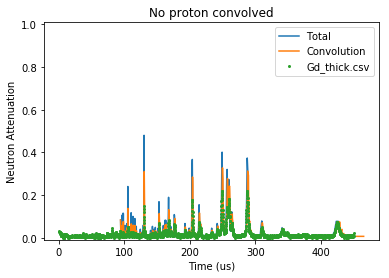

In [3]:
plt.show()

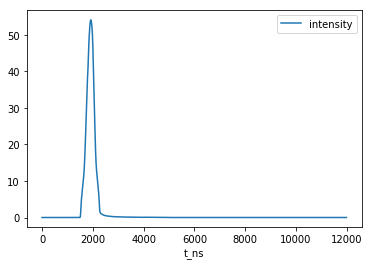

In [5]:
simulation.neutron_pulse.proton_pulse.shape_df.set_index('t_ns').plot()

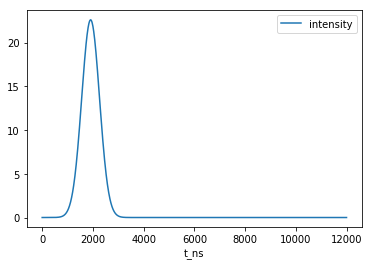

In [14]:
simulation.neutron_pulse.proton_pulse.make_new_shape(sigma=350)
simulation.neutron_pulse.proton_pulse.shape_df.set_index('t_ns').plot()

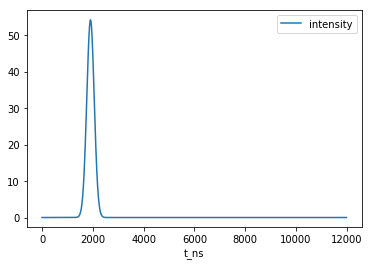

In [9]:
simulation.neutron_pulse.proton_pulse.make_new_shape(sigma=146)
simulation.neutron_pulse.proton_pulse.shape_df.set_index('t_ns').plot()

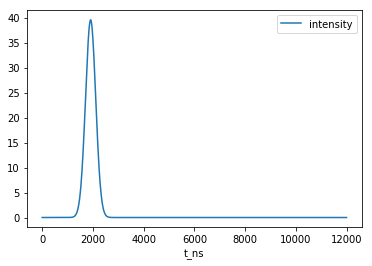

In [11]:
simulation.neutron_pulse.proton_pulse.make_new_shape(sigma=200)
simulation.neutron_pulse.proton_pulse.shape_df.set_index('t_ns').plot()

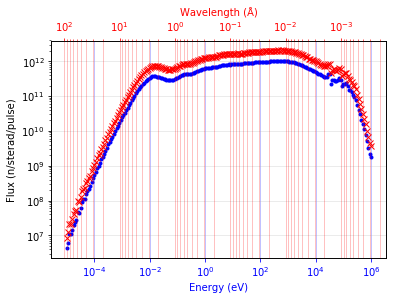

In [5]:
simulation.neutron_pulse.plot_shape_total()

In [11]:
tof_us = simulation.neutron_pulse.shape_tof_df_interp['tof_us']

In [8]:
total_interp = simulation.neutron_pulse.shape_tof_df_interp.set_index('tof_us').sum(axis=1)

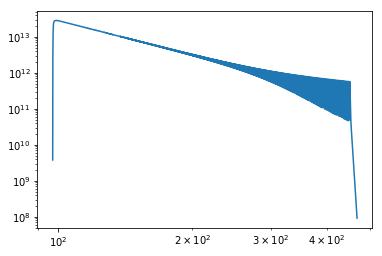

In [15]:
plt.loglog(tof_us, total_interp)

In [30]:
tof_us = simulation.neutron_pulse.shape_tof_df_interp['tof_us']
pulse_60 = simulation.neutron_pulse.shape_tof_df_interp['60.0']
pulse_60

0         0.000000e+00
1         0.000000e+00
2         0.000000e+00
3         0.000000e+00
4         0.000000e+00
5         0.000000e+00
6         0.000000e+00
7         0.000000e+00
8         0.000000e+00
9         0.000000e+00
10        0.000000e+00
11        0.000000e+00
12        0.000000e+00
13        0.000000e+00
14        0.000000e+00
15        0.000000e+00
16        0.000000e+00
17        0.000000e+00
18        0.000000e+00
19        0.000000e+00
20        0.000000e+00
21        0.000000e+00
22        0.000000e+00
23        0.000000e+00
24        0.000000e+00
25        0.000000e+00
26        0.000000e+00
27        0.000000e+00
28        0.000000e+00
29        0.000000e+00
             ...      
80684    4.675950e-130
80685    4.372047e-130
80686    4.202673e-130
80687    3.933609e-130
80688    2.237077e-130
80689    2.150654e-130
80690    1.539581e-130
80691    1.296277e-130
80692    1.225683e-130
80693    9.397256e-131
80694    6.453813e-131
80695    5.284186e-131
80696    3.

In [33]:
simulation.neutron_pulse.shape_tof_df_interp

,tof_us,7.0,7.1,7.2,7.3,7.4,7.5,7.6,7.7,7.8,...,149.1,149.2,149.3,149.4,149.5,149.6,149.7,149.8,149.9,150.0
0,97.230491,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.777957e+09
1,97.239301,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.160424e+10
2,97.248701,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.483781e+11
3,97.258711,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.863716e+11
4,97.262873,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.647566e+09,5.966395e+11
5,97.269391,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.229284e+10,7.768528e+11
6,97.271683,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.099990e+10,8.415092e+11
7,97.280771,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.407789e+11,1.099215e+12
8,97.281083,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.473434e+11,1.108012e+12
9,97.291093,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.849667e+11,1.384640e+12


In [77]:
_temp_df = neutron_pulse.proton_df
_max = max(_temp_df['intensity'])
_temp_df['norm'] = _temp_df['intensity']/_max
_temp_df = _temp_df.drop(_temp_df[_temp_df.norm <= 0.01].index)

In [78]:
_temp_df

,t_ns,intensity,norm
152,1520,1.120640,0.020716
153,1530,2.435963,0.045030
154,1540,3.745204,0.069232
155,1550,4.767047,0.088122
156,1560,5.633867,0.104145
157,1570,6.374172,0.117830
158,1580,7.032163,0.129994
159,1590,7.697528,0.142293
160,1600,8.327345,0.153936
161,1610,8.999129,0.166354


97

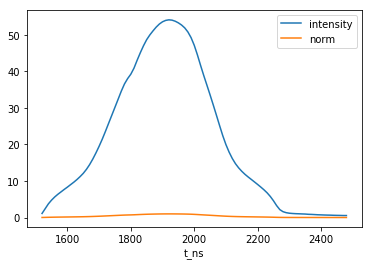

In [79]:
_temp_df.set_index('t_ns').plot()
# plt.xlim(left=1400, right=2500)
proton_yy = _temp_df['intensity']
len(proton_yy)

In [60]:
neutron_pulse = go.Scatter(
    x = tof_us,
    y = pulse_60,
    mode = 'lines',
    name = 'lines'
)

plotly.offline.iplot([neutron_pulse])

In [61]:
t_ns = simulation.neutron_pulse.proton_df['t_ns']
proton_y = simulation.neutron_pulse.proton_df['intensity']
proton_pulse = go.Scatter(
    x = t_ns,
    y = proton_y,
    mode = 'lines',
    name = 'lines'
)
plotly.offline.iplot([proton_pulse])


In [62]:
conv = go.Scatter(
    x = tof_us,
    y = conv1,
    mode = 'lines',
    name = 'lines'
)
plotly.offline.iplot([conv])

In [42]:
a =conv1/pulse_60

In [63]:
diff = go.Scatter(
    x = tof_us,
    y = a,
    mode = 'lines',
    name = 'lines'
)
plotly.offline.iplot([diff])

(0, 1500)

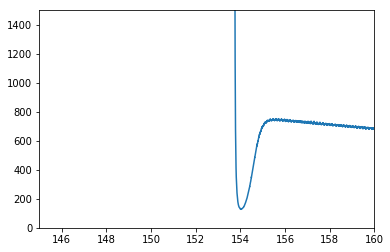

In [50]:
plt.plot(tof_us, a)
plt.xlim(left=145, right=160)
plt.ylim(top=1500, bottom=0)

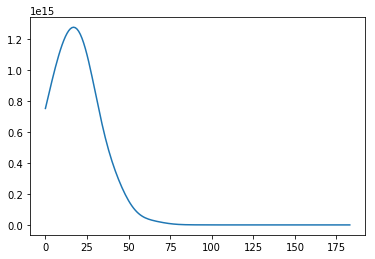

In [85]:
conv2 = np.convolve(proton_yy,pulse_60, mode='same')
plt.plot(conv2)
# plt.xlim(left=50, right=200)

In [51]:
all(conv1 == conv2)

True

(-10, 120)

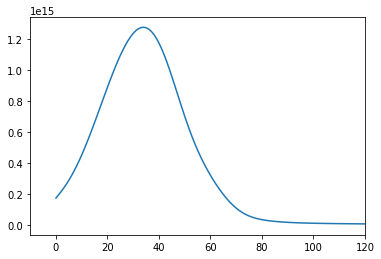

In [52]:
conv3 = np.convolve(pulse_60, proton_y, mode='valid')
plt.plot(conv3)
plt.xlim(left=-10, right=120)

(120, 320)

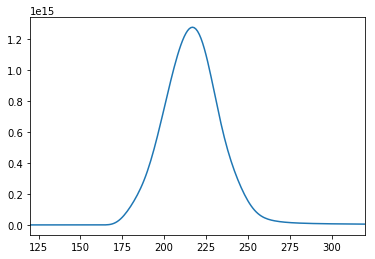

In [56]:
conv3 = np.convolve(pulse_60, proton_y, mode='full')
plt.plot(conv3)
plt.xlim(left=120, right=320)

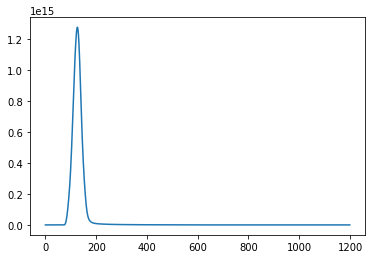

In [31]:
conv = np.convolve(proton_y, pulse_60, mode='same')
plt.plot(conv)

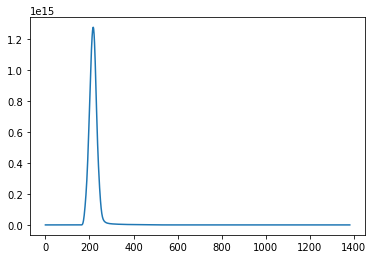

In [32]:
conv = np.convolve(proton_y, pulse_60, mode='full')
plt.plot(conv)